# Proyecto: 
## Arbolado Ciudad de Buenos Aires 🌳


### Introducción
En este proyecto de análisis de datos, exploraremos un archivo de base de datos de películas de TMDb, que cuenta con información importante de más de 10.000 películas, incluyendo detalles sobre presupuesto, ingresos, fechas de estreno, entre otros.

A lo largo de este análisis, utilizaremos diferentes herramientas y técnicas para explorar, visualizar y entender mejor los datos que contiene esta base de datos de películas. Exploraremos preguntas como ¿cuáles son las películas más populares? ¿Cuál es la relación entre el presupuesto y los ingresos de una película? ¿Cómo ha evolucionado la industria cinematográfica a lo largo del tiempo?

¡Prepárate para sumergirte en el mundo del cine y el análisis de datos con nosotros!

In [1]:
import pandas as pd
import numpy as np
import re
import matplotlib.pyplot as plt
import seaborn as sns
import missingno as msno
import folium
from folium.plugins import HeatMap
from branca.colormap import LinearColormap
from tabulate import tabulate


In [14]:
pip install tabulate


Note: you may need to restart the kernel to use updated packages.


**Visualizar la Base de Datos**

In [2]:
import pandas as pd

# Leer el archivo Excel
arbolado = pd.read_excel('Arbolado.xlsx')

# Ajustar el ancho de las columnas
pd.set_option("display.max_colwidth", None)

# Mostrar las primeras 5 filas del DataFrame
print(arbolado.head(5))


        long        lat nro_registro tipo_activ  comuna manzana  \
0 -58.378563 -34.594902        26779     Lineal       1     NaN   
1 -58.381532 -34.592319        30887     Lineal       1     NaN   
2 -58.379103 -34.591939        30904     Lineal       1     NaN   
3 -58.380710 -34.591548        31336     Lineal       1     NaN   
4 -58.380710 -34.591548        31337     Lineal       1     NaN   

        calle_nombre calle_altura calle_chapa    direccion_normalizada  \
0          Esmeralda         1000        1120           ESMERALDA 1120   
1  Pellegrini Carlos         1300        1345  PELLEGRINI, CARLOS 1345   
2             Arroyo          800         848               ARROYO 848   
3             Arroyo          900         932               ARROYO 932   
4             Arroyo          900         932               ARROYO 932   

  ubicacion       nombre_cientifico ancho_acera estado_plantera  \
0       NaN            Tipuana tipu         5.5         Ocupada   
1    Exacta      P

Contemplamos la cantidad de datos.

In [10]:
rows, col = arbolado.shape
print('En total hay {} árboles en sus veredad (no se cuentan los 50 mil aprox. que están en plazas y parques) y {} columnas con distintos datos en esta base.'.format(rows-1, col))


En total hay 370179 árboles (no se cuentan los 50 mil aprox. que están en plazas y parques) y 18 columnas con distintos datos en esta base.


Ver que columnas tienen mayor cantidad de nulls.

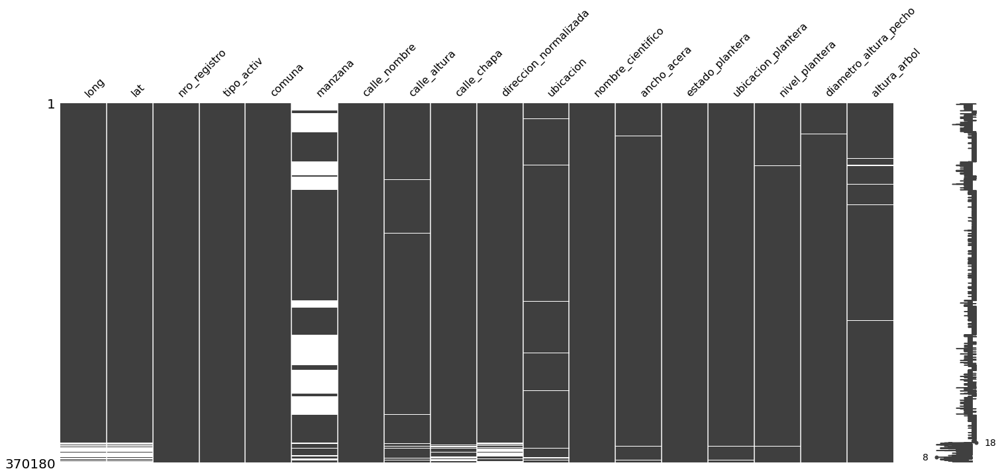

In [11]:

# Crear la matriz de visualización de valores nulos
msno.matrix(arbolado)

# Mostrar el gráfico
plt.show()


In [34]:
import folium

# Filtrar las filas con coordenadas no nulas
arbolado_con_coords = arbolado.dropna(subset=['lat', 'long'])

# Crear un mapa centrado en las coordenadas promedio
mapa_puntos = folium.Map(location=[arbolado_con_coords['lat'].mean(), arbolado_con_coords['long'].mean()], zoom_start=12)

# Añadir un marcador por cada árbol
for index, row in arbolado_con_coords.iterrows():
    folium.Marker([row['lat'], row['long']], popup=row['nombre_cientifico']).add_to(mapa_puntos)

# Mostrar el mapa
mapa_puntos


**Mapa de calor**

En las zonas de verde oscuro se visualizan las áreas con más arboles (los parques no están representados).



In [65]:

# Filtrar las filas con coordenadas no nulas
arbolado_con_coords = arbolado.dropna(subset=['lat', 'long'])

# Crear un mapa centrado en las coordenadas promedio
mapa_calor = folium.Map(location=[arbolado_con_coords['lat'].mean(), arbolado_con_coords['long'].mean()], zoom_start=12)

# Crear una lista de coordenadas
datos_calor = arbolado_con_coords[['lat', 'long']].values.tolist()

# Crear un mapa de colores personalizado
colormap = LinearColormap(['white', 'darkgreen'], vmin=0, vmax=1)

# Ajustar la escala de colores en la capa de mapa de calor
HeatMap(datos_calor, radius=7, blur=10, gradient={0.5: colormap(0), 0.5: colormap(0.3), 1.0: colormap(1)}).add_to(mapa_calor)

# Añadir la barra de colores al mapa
colormap.add_to(mapa_calor)

# Mostrar el mapa
mapa_calor

In [32]:

# Filtrar los árboles con más de 10 metros
arbolado_mayor_10m = arbolado[arbolado['altura_arbol'] > 20]

# Filtrar las filas con coordenadas no nulas
arbolado_con_coords = arbolado_mayor_10m.dropna(subset=['lat', 'long'])

# Crear un mapa centrado en las coordenadas promedio
mapa_calor = folium.Map(location=[arbolado_con_coords['lat'].mean(), arbolado_con_coords['long'].mean()], zoom_start=12)

# Crear una lista de coordenadas
datos_calor = arbolado_con_coords[['lat', 'long']].values.tolist()

# Crear un mapa de colores personalizado
colormap = LinearColormap(['white', 'darkgreen'], vmin=0, vmax=1)

# Ajustar la escala de colores en la capa de mapa de calor
HeatMap(datos_calor, radius=7, blur=10, gradient={0.5: colormap(0), 0.5: colormap(0.3), 1.0: colormap(1)}).add_to(mapa_calor)

# Añadir la barra de colores al mapa
colormap.add_to(mapa_calor)

# Mostrar el mapa
mapa_calor

**Mapa de calor**

Idéntico al gráfico anterior pero con otras tonalidades, para que se visualice de forma más sencilla.

En las zonas rojas se visualizan las áreas con más arboles, en amarillo las intermedias y en verde claro las que menos arboles poseen.

In [28]:

# Filtrar los árboles con más de 10 metros
arbolado_mayor_10m = arbolado[arbolado['altura_arbol'] > 20]

# Filtrar las filas con coordenadas no nulas
arbolado_con_coords = arbolado_mayor_10m.dropna(subset=['lat', 'long'])

# Crear un mapa centrado en las coordenadas promedio
mapa_calor = folium.Map(location=[arbolado_con_coords['lat'].mean(), arbolado_con_coords['long'].mean()], zoom_start=12)

# Crear una lista de coordenadas
datos_calor = arbolado_con_coords[['lat', 'long']].values.tolist()

# Añadir la capa de mapa de calor con parámetros ajustados
HeatMap(datos_calor, radius=7, blur=10).add_to(mapa_calor)

# Mostrar el mapa
mapa_calor


In [30]:

# Filtrar los árboles con menos de 5 metros
arbolado_menor_5m = arbolado[arbolado['altura_arbol'] < 10]

# Filtrar las filas con coordenadas no nulas
arbolado_con_coords = arbolado_menor_5m.dropna(subset=['lat', 'long'])

# Crear un mapa centrado en las coordenadas promedio
mapa_calor = folium.Map(location=[arbolado_con_coords['lat'].mean(), arbolado_con_coords['long'].mean()], zoom_start=12)

# Crear una lista de coordenadas
datos_calor = arbolado_con_coords[['lat', 'long']].values.tolist()

# Añadir la capa de mapa de calor con parámetros ajustados
HeatMap(datos_calor, radius=7, blur=10).add_to(mapa_calor)

# Mostrar el mapa
mapa_calor

Distribucion de especies

In [16]:

# Definir el diccionario de reemplazo de nombres de especies específicas
reemplazos_especies = {
    'Fraxinus pennsylvanica': 'Fresno Americano',
    'Fraxinus americana': 'Fresno Americano',
    'Platanus x acerifolia': 'Platano',
    'Ficus benjamina': 'Ficus',
    'Tilia x moltkei': 'Tilo',
    'Melia azedarach': 'Paraiso',
    'Jacaranda mimosifolia': 'Jacaranda',
    'Lagerstroemia indica': 'Lila del Sur',
    'Tipuana tipu': 'Tipa',
    'Ligustrum lucidum': 'Aligustre',
    'Fraxinus excelsior': 'Fresno norteño'
}

# Reemplazar el nombre de las especies específicas
arbolado['nombre_cientifico'] = arbolado['nombre_cientifico'].replace(reemplazos_especies)

# Filtrar las filas donde la especie no sea "No identificado"
arbolado_filtrado = arbolado[arbolado['nombre_cientifico'] != 'No identificado']

# Calcular el porcentaje de cada especie y seleccionar las 10 más comunes
porcentaje_especies_comunes = (arbolado_filtrado['nombre_cientifico'].value_counts() / len(arbolado_filtrado) * 100).head(10)

# Crear un DataFrame con las especies y sus porcentajes
top_10_especies_df = pd.DataFrame({
    'Especie': porcentaje_especies_comunes.index,
    'Porcentaje': porcentaje_especies_comunes.values
})

# Mostrar el DataFrame con tabulate
print(tabulate(top_10_especies_df, headers='keys', tablefmt='fancy_grid', showindex=False))

╒══════════════════╤══════════════╕
│ Especie          │   Porcentaje │
╞══════════════════╪══════════════╡
│ Fresno Americano │     39.8393  │
├──────────────────┼──────────────┤
│ Platano          │      8.95836 │
├──────────────────┼──────────────┤
│ Ficus            │      6.2389  │
├──────────────────┼──────────────┤
│ Tilo             │      4.32548 │
├──────────────────┼──────────────┤
│ Paraiso          │      4.13034 │
├──────────────────┼──────────────┤
│ Jacaranda        │      3.84512 │
├──────────────────┼──────────────┤
│ Lila del Sur     │      3.29463 │
├──────────────────┼──────────────┤
│ Tipa             │      2.58614 │
├──────────────────┼──────────────┤
│ Aligustre        │      2.48303 │
├──────────────────┼──────────────┤
│ Fresno norteño   │      2.38019 │
╘══════════════════╧══════════════╛


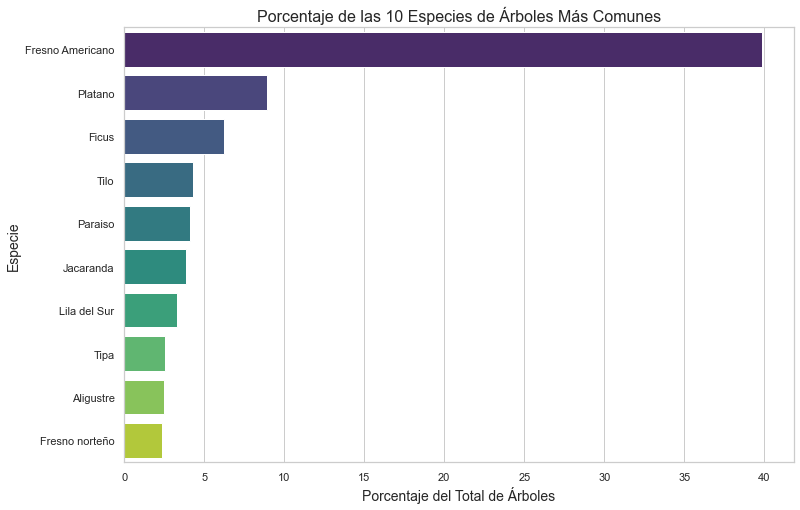

In [12]:

# Definir el diccionario de reemplazo de nombres de especies específicas
reemplazos_especies = {
    'Fraxinus pennsylvanica': 'Fresno Americano',
    'Fraxinus americana': 'Fresno Americano',
    'Platanus x acerifolia': 'Platano',
    'Ficus benjamina': 'Ficus',
    'Tilia x moltkei': 'Tilo',
    'Melia azedarach': 'Paraiso',
    'Jacaranda mimosifolia': 'Jacaranda',
    'Lagerstroemia indica': 'Lila del Sur',
    'Tipuana tipu': 'Tipa',
    'Ligustrum lucidum': 'Aligustre',
    'Fraxinus excelsior': 'Fresno norteño'
}

# Reemplazar el nombre de las especies específicas
arbolado['nombre_cientifico'] = arbolado['nombre_cientifico'].replace(reemplazos_especies)

# Filtrar las filas donde la especie no sea "No identificado"
arbolado_filtrado = arbolado[arbolado['nombre_cientifico'] != 'No identificado']

# Calcular el porcentaje de cada especie y seleccionar las 10 más comunes
porcentaje_especies_comunes = (arbolado_filtrado['nombre_cientifico'].value_counts() / len(arbolado_filtrado) * 100).head(10)

# Configurar el estilo de seaborn
sns.set(style="whitegrid")
plt.figure(figsize=(12, 8))

# Crear un gráfico de barras horizontales con seaborn
ax = sns.barplot(x=porcentaje_especies_comunes.values, y=porcentaje_especies_comunes.index, palette="viridis")

# Configurar el gráfico
ax.set_title('Porcentaje de las 10 Especies de Árboles Más Comunes', fontsize=16)
ax.set_xlabel('Porcentaje del Total de Árboles', fontsize=14)
ax.set_ylabel('Especie', fontsize=14)

# Mostrar el gráfico
plt.show()

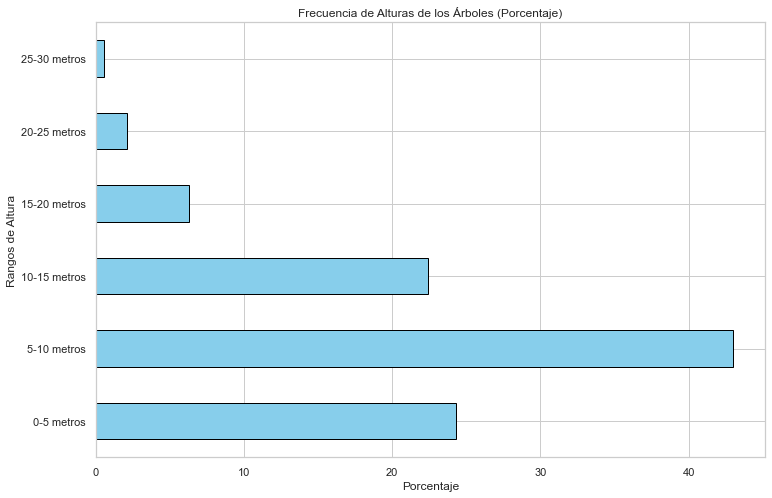

In [8]:
# Crear los bins para la altura de los árboles
# Crear los bins para la altura de los árboles
bins = [i for i in range(0, 31, 5)]  # Ajuste el rango final y el paso

# Aplicar el binning y contar la frecuencia en cada bin
frecuencia_alturas = pd.cut(arbolado['altura_arbol'], bins=bins, include_lowest=True).value_counts().sort_index()

# Calcular los porcentajes
porcentaje_alturas = frecuencia_alturas / len(arbolado) * 100

# Configurar el tamaño del gráfico
plt.figure(figsize=(12, 8))  # Ajustar el tamaño de la figura

# Crear un gráfico de barras horizontales
porcentaje_alturas.plot(kind='barh', color='skyblue', edgecolor='black')

# Configurar las etiquetas del eje Y
etiquetas_y = [f'{int(bin.left)}-{int(bin.right)} metros' for bin in porcentaje_alturas.index]
plt.yticks(range(len(etiquetas_y)), etiquetas_y)

# Configurar el título y etiquetas
plt.title('Frecuencia de Alturas de los Árboles (Porcentaje)')
plt.xlabel('Porcentaje')
plt.ylabel('Rangos de Altura')

# Mostrar el gráfico
plt.show()



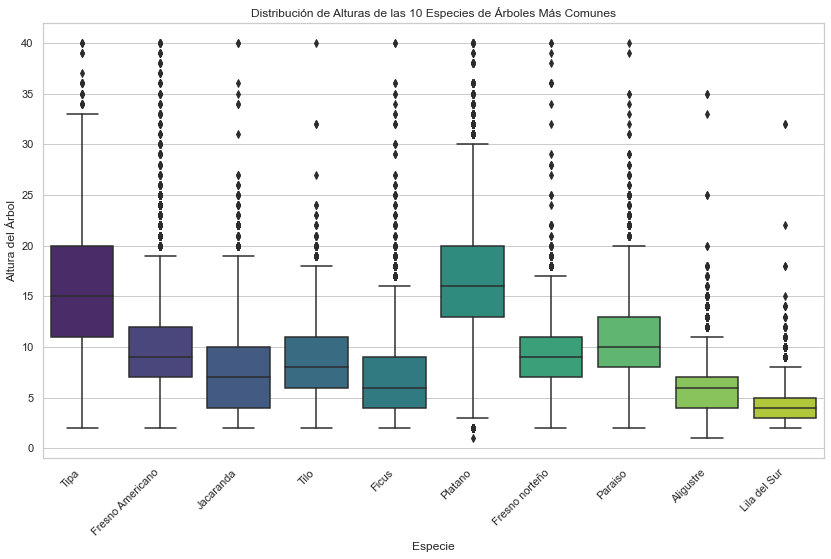

In [17]:

# Definir el diccionario de reemplazo de nombres de especies específicas
reemplazos_especies = {
    'Fraxinus pennsylvanica': 'Fresno Americano',
    'Fraxinus americana': 'Fresno Americano',
    'Platanus x acerifolia': 'Platano',
    'Ficus benjamina': 'Ficus',
    'Tilia x moltkei': 'Tilo',
    'Melia azedarach': 'Paraiso',
    'Jacaranda mimosifolia': 'Jacaranda',
    'Lagerstroemia indica': 'Lila del Sur',
    'Tipuana tipu': 'Tipa',
    'Ligustrum lucidum': 'Aligustre',
    'Fraxinus excelsior': 'Fresno norteño'
}

# Reemplazar el nombre de las especies específicas
arbolado['nombre_cientifico'] = arbolado['nombre_cientifico'].replace(reemplazos_especies)

# Filtrar las filas donde la especie no sea "No identificado"
arbolado_filtrado = arbolado[arbolado['nombre_cientifico'] != 'No identificado']

# Seleccionar las principales 10 especies
top_10_especies = porcentaje_especies_comunes.index

# Filtrar el DataFrame por las 10 especies principales
arbolado_top_10_especies = arbolado_filtrado[arbolado_filtrado['nombre_cientifico'].isin(top_10_especies)]

# Configurar el estilo de seaborn
sns.set(style="whitegrid")
plt.figure(figsize=(14, 8))

# Crear un gráfico de caja (boxplot)
sns.boxplot(x='nombre_cientifico', y='altura_arbol', data=arbolado_top_10_especies, palette="viridis")
plt.title('Distribución de Alturas de las 10 Especies de Árboles Más Comunes')
plt.xlabel('Especie')
plt.ylabel('Altura del Árbol')

# Rotar etiquetas del eje x para mayor legibilidad
plt.xticks(rotation=45, ha='right')

# Mostrar el gráfico
plt.show()

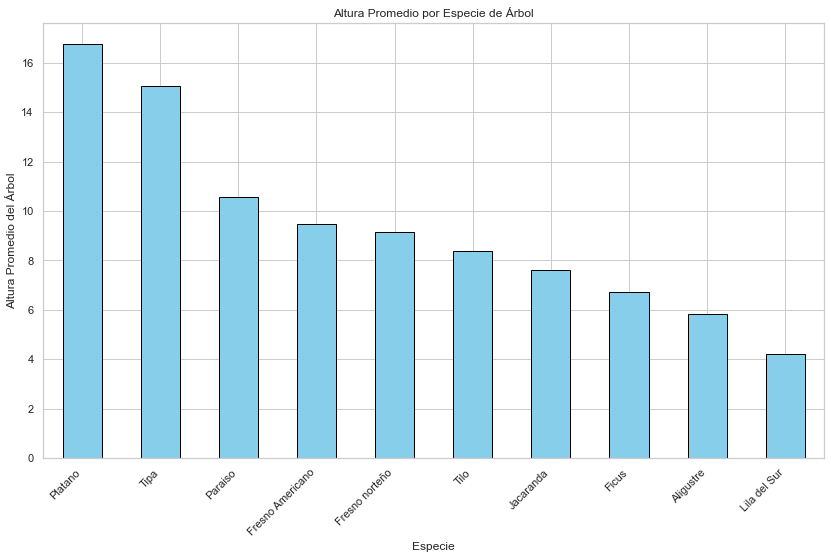

In [9]:
# Definir el diccionario de reemplazo de nombres de especies específicas
reemplazos_especies = {
    'Fraxinus pennsylvanica': 'Fresno Americano',
    'Fraxinus americana': 'Fresno Americano',
    'Platanus x acerifolia': 'Platano',
    'Ficus benjamina': 'Ficus',
    'Tilia x moltkei': 'Tilo',
    'Melia azedarach': 'Paraiso',
    'Jacaranda mimosifolia': 'Jacaranda',
    'Lagerstroemia indica': 'Lila del Sur',
    'Tipuana tipu': 'Tipa',
    'Ligustrum lucidum': 'Aligustre',
    'Fraxinus excelsior': 'Fresno norteño'
}

# Reemplazar el nombre de las especies específicas
arbolado['nombre_cientifico'] = arbolado['nombre_cientifico'].replace(reemplazos_especies)

# Filtrar las filas donde la especie no sea "No identificado"
arbolado_filtrado = arbolado[arbolado['nombre_cientifico'] != 'No identificado']

# Seleccionar las principales 10 especies
top_10_especies = porcentaje_especies_comunes.index

# Filtrar el DataFrame por las 10 especies principales
arbolado_top_10_especies = arbolado_filtrado[arbolado_filtrado['nombre_cientifico'].isin(top_10_especies)]

# Calcular la altura promedio por especie
altura_promedio_por_especie = arbolado_top_10_especies.groupby('nombre_cientifico')['altura_arbol'].mean().sort_values(ascending=False)

# Configurar el tamaño del gráfico
plt.figure(figsize=(14, 8))

# Crear un gráfico de barras
altura_promedio_por_especie.plot(kind='bar', color='skyblue', edgecolor='black')

# Configurar el título y etiquetas
plt.title('Altura Promedio por Especie de Árbol')
plt.xlabel('Especie')
plt.ylabel('Altura Promedio del Árbol')

# Rotar etiquetas del eje x para mayor legibilidad
plt.xticks(rotation=45, ha='right')

# Mostrar el gráfico
plt.show()


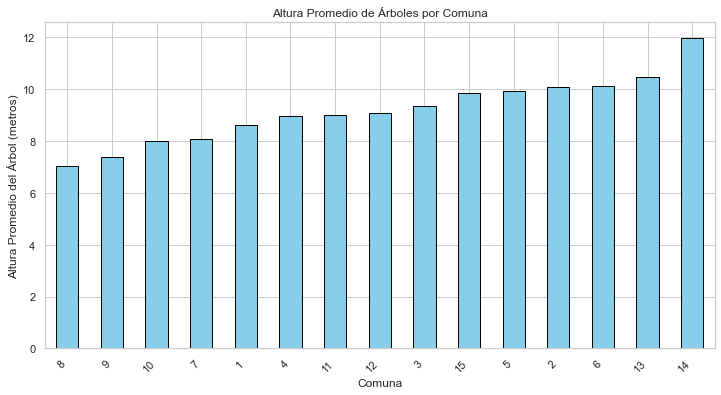

In [24]:

# Calcular la altura promedio por comuna
altura_promedio_por_comuna = arbolado.groupby('comuna')['altura_arbol'].mean().sort_values()

# Configurar el tamaño del gráfico
plt.figure(figsize=(12, 6))

# Crear un gráfico de barras
altura_promedio_por_comuna.plot(kind='bar', color='skyblue', edgecolor='black')

# Configurar el título y etiquetas
plt.title('Altura Promedio de Árboles por Comuna')
plt.xlabel('Comuna')
plt.ylabel('Altura Promedio del Árbol (metros)')

# Rotar etiquetas del eje x para mayor legibilidad
plt.xticks(rotation=45, ha='right')

# Mostrar el gráfico
plt.show()

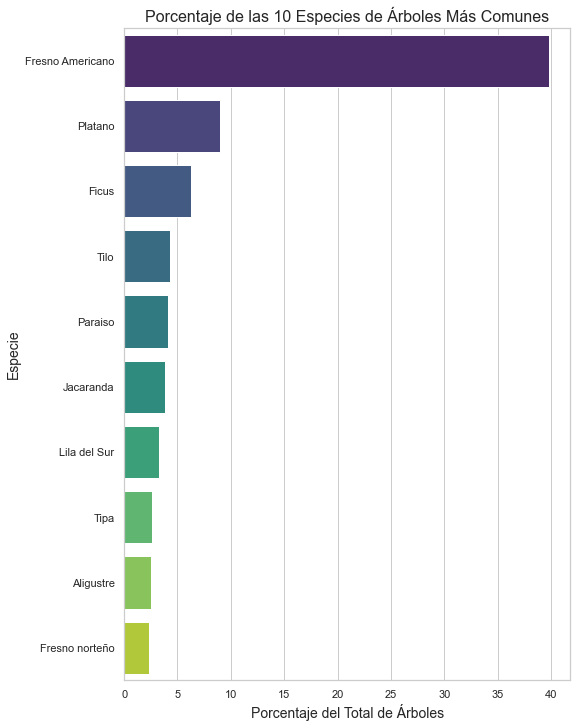

In [3]:
import seaborn as sns
import matplotlib.pyplot as plt

# Definir el diccionario de reemplazo de nombres de especies específicas
reemplazos_especies = {
    'Fraxinus pennsylvanica': 'Fresno Americano',
    'Fraxinus americana': 'Fresno Americano',
    'Platanus x acerifolia': 'Platano',
    'Ficus benjamina': 'Ficus',
    'Tilia x moltkei': 'Tilo',
    'Melia azedarach': 'Paraiso',
    'Jacaranda mimosifolia': 'Jacaranda',
    'Lagerstroemia indica': 'Lila del Sur',
    'Tipuana tipu': 'Tipa',
    'Ligustrum lucidum': 'Aligustre',
    'Fraxinus excelsior': 'Fresno norteño'
}

# Reemplazar el nombre de las especies específicas
arbolado['nombre_cientifico'] = arbolado['nombre_cientifico'].replace(reemplazos_especies)

# Filtrar las filas donde la especie no sea "No identificado"
arbolado_filtrado = arbolado[arbolado['nombre_cientifico'] != 'No identificado']

# Calcular el porcentaje de cada especie y seleccionar las 10 más comunes
porcentaje_especies_comunes = (arbolado_filtrado['nombre_cientifico'].value_counts() / len(arbolado_filtrado) * 100).head(10)

# Configurar el estilo de seaborn
sns.set(style="whitegrid")
plt.figure(figsize=(8, 12))  # Cambiar el tamaño de la figura

# Crear un gráfico de barras horizontales con seaborn
ax = sns.barplot(x=porcentaje_especies_comunes.values, y=porcentaje_especies_comunes.index, palette="viridis", orient="h")  # Cambiar la orientación

# Configurar el gráfico
ax.set_title('Porcentaje de las 10 Especies de Árboles Más Comunes', fontsize=16)
ax.set_xlabel('Porcentaje del Total de Árboles', fontsize=14)
ax.set_ylabel('Especie', fontsize=14)

# Mostrar el gráfico
plt.show()


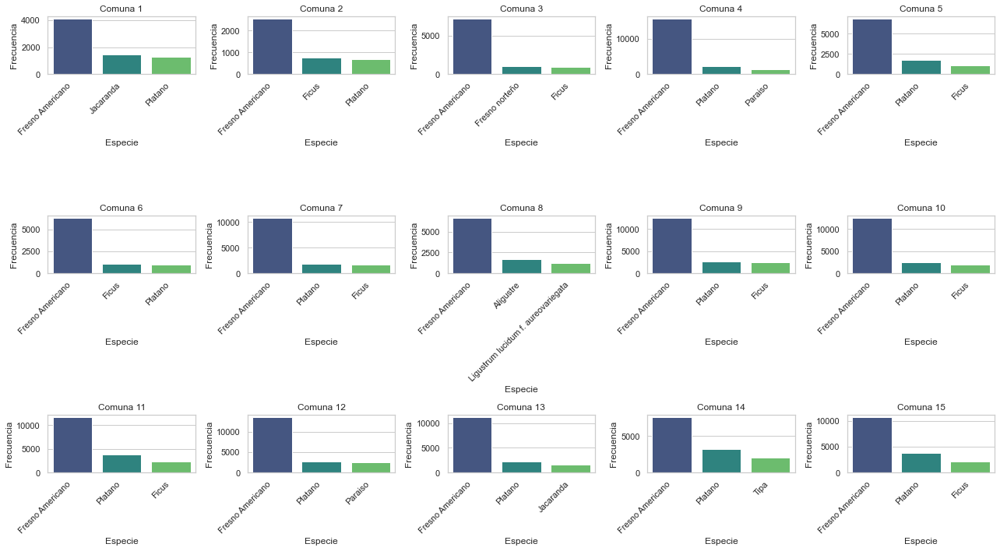

In [16]:

# Filtrar las filas con coordenadas no nulas
arbolado_con_coords = arbolado.dropna(subset=['lat', 'long'])

# Filtrar las filas donde la especie no sea "No identificado"
arbolado_filtrado = arbolado_con_coords[arbolado_con_coords['nombre_cientifico'] != 'No identificado']

# Configurar el estilo de seaborn
sns.set(style="whitegrid")

# Obtener la lista de comunas
comunas = arbolado_filtrado['comuna'].unique()

# Configurar el tamaño del gráfico
plt.figure(figsize=(18, 10))

# Iterar sobre cada comuna para crear un gráfico individual
for i, comuna in enumerate(comunas, 1):
    # Filtrar por comuna
    arbolado_comuna = arbolado_filtrado[arbolado_filtrado['comuna'] == comuna]
    
    # Obtener las 3 especies más frecuentes
    especies_frecuentes = arbolado_comuna['nombre_cientifico'].value_counts().head(3).index
    
    # Filtrar por las especies más frecuentes
    arbolado_especies_frecuentes = arbolado_comuna[arbolado_comuna['nombre_cientifico'].isin(especies_frecuentes)]
    
    # Crear un gráfico de barras por comuna
    plt.subplot(3, 5, i)
    sns.countplot(x='nombre_cientifico', data=arbolado_especies_frecuentes, palette='viridis', order=especies_frecuentes)
    plt.title(f'Comuna {comuna}')
    plt.xlabel('Especie')
    plt.ylabel('Frecuencia')
    plt.xticks(rotation=45, ha='right')

# Ajustar el diseño y mostrar los gráficos
plt.tight_layout()
plt.show()


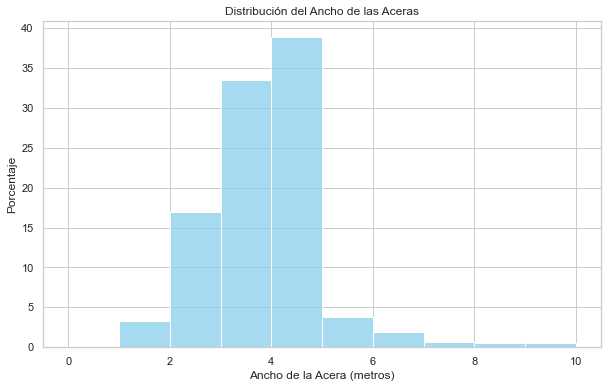

In [33]:
import seaborn as sns
import matplotlib.pyplot as plt

# Supongamos que la columna que contiene el ancho de la acera se llama 'ancho_acera'
# Ajusta esto según el nombre real de tu columna
ancho_acera = arbolado['ancho_acera']

# Intentar convertir la columna a tipo numérico, ignorando los errores
ancho_acera_numeric = pd.to_numeric(ancho_acera, errors='coerce')

# Eliminar valores NaN
ancho_acera_numeric = ancho_acera_numeric.dropna()

# Configurar el estilo de seaborn
sns.set(style="whitegrid")

# Configurar el tamaño del gráfico
plt.figure(figsize=(10, 6))

# Crear un histograma con seaborn
sns.histplot(ancho_acera_numeric, bins=range(11), color='skyblue', stat='percent')

# Configurar el título y etiquetas
plt.title('Distribución del Ancho de las Aceras')
plt.xlabel('Ancho de la Acera (metros)')
plt.ylabel('Porcentaje')

# Mostrar el gráfico
plt.show()



